## EDEP SIMULATION ANALYSIS ## 

*The objective of this script is to analyze the neutral current events obtained through a Monte-Carlo's simulation.*

The data is located in a ".hdf5" file which contains all the raw data in a no array-like structure. The data is set different from each other using the numpy datatype method. The contents of the file have five different kind of main distinc arangements:
- mc_hdr (has the information for the kind of event we are seeing)
- mc_stack
- segments (The true hits of particles)
- trajectories (The simulated trajectories of the particles)
- vertices

On each, the data can be contrasted from other using the dtype method. 

**NOTE**: I'm using the NDLAR simulation converted to hdf5 file from local.

### Let's start the program ###

In [1]:
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import h5py
import numpy as np
from matplotlib import cm, colors

#Let's import the file:
sim_file='C:/Users/enriq/Documents/MicroProdN1p2_NDLAr_1E18_RHC.convert2h5.nu.0000100.EDEPSIM.hdf5'
sim_h5= h5py.File(sim_file,'r')
#And observe the file contents.
print('\n----------------- File content -----------------')
print('File:',sim_file)
print('Keys in file:',list(sim_h5.keys()))
for key in sim_h5.keys():
    print('Number of',key,'entries in file:', len(sim_h5[key]))
print('------------------------------------------------\n')
# Let's split the datasets that we have.
mc_hdr = sim_h5['mc_hdr']
mc_stack = sim_h5['mc_stack']
segments = sim_h5['segments']
trajectories = sim_h5['trajectories']
vertices= sim_h5['vertices']
# Also let's declare the  particles that we would like to see.
# This will come in handy later on the scipt
pdg_color = { 
11 : 'blue', #electron
13 : 'purple', #muon
22 :  'yellow', #gamma
2212:  'black', #proton
2112:  'gray', #neutron
111:   'pink', #pi0
211:   'cyan', #pi+
0: 'red',
11: 'blue', #positron
#14: 'green' # muon neutrino
}
labels = pdg_color.keys()
#Let's also print the information inside the mc_hdr for the type of events that we have.
print("Kinds of objects inside the mc_hdr dataset: ")
print("")
print(mc_hdr.dtype)
print("")
#We put the information of one event in just one dataset
mc_event=mc_hdr[mc_hdr['event_id']==100001]
events_ids, counts=np.unique(segments['event_id'],return_counts=True)
print(mc_event)
print("")
print("number of events")
print(events_ids,counts)


----------------- File content -----------------
File: C:/Users/enriq/Documents/MicroProdN1p2_NDLAr_1E18_RHC.convert2h5.nu.0000100.EDEPSIM.hdf5
Keys in file: ['mc_hdr', 'mc_stack', 'segments', 'trajectories', 'vertices']
Number of mc_hdr entries in file: 2040
Number of mc_stack entries in file: 19137
Number of segments entries in file: 6582081
Number of trajectories entries in file: 4369814
Number of vertices entries in file: 2040
------------------------------------------------

Kinds of objects inside the mc_hdr dataset: 

{'names': ['event_id', 'vertex_id', 'x_vert', 'y_vert', 'z_vert', 't_vert', 'target', 'reaction', 'isCC', 'isQES', 'isMEC', 'isRES', 'isDIS', 'isCOH', 'Enu', 'nu_4mom', 'nu_pdg', 'Elep', 'lep_mom', 'lep_ang', 'lep_pdg', 'q0', 'q3', 'Q2', 'x', 'y'], 'formats': ['<u4', '<u8', '<f4', '<f4', '<f4', '<f8', '<u4', '<i4', '?', '?', '?', '?', '?', '?', '<f4', ('<f4', (4,)), '<i4', '<f4', '<f4', '<f4', '<i4', '<f4', '<f4', '<f4', '<f4', '<f4'], 'offsets': [0, 8, 16, 20, 24

100000
0 211 1000000003
[1000000003, 1000000003, 1000000004] [1000000003 1000000004 1000000015]
3 3
0
1 -211 1000000003
[1000000003, 1000000003, 1000000004] [1000000003 1000000004 1000000015]
3 3
0


C:\Users\enriq\AppData\Local\Temp\ipykernel_17532\3305513895.py:33: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  index=int(np.where(NC_EVENTS['vertex_id']==interact_vert[i])[0])


2 2212 1000000004
[1000000003, 1000000003, 1000000004] [1000000003 1000000004 1000000015]
3 3
1
100001
0 -211 1000000030
[1000000030, 1000000030, 1000000034, 1000000034, 1000000034, 1000000034] [1000000027 1000000030 1000000034 1000000035]
6 4
1
1 211 1000000030
[1000000030, 1000000030, 1000000034, 1000000034, 1000000034, 1000000034] [1000000027 1000000030 1000000034 1000000035]
6 4
1
2 -211 1000000034
[1000000030, 1000000030, 1000000034, 1000000034, 1000000034, 1000000034] [1000000027 1000000030 1000000034 1000000035]
6 4
2
3 2212 1000000034
[1000000030, 1000000030, 1000000034, 1000000034, 1000000034, 1000000034] [1000000027 1000000030 1000000034 1000000035]
6 4
2
4 -211 1000000034
[1000000030, 1000000030, 1000000034, 1000000034, 1000000034, 1000000034] [1000000027 1000000030 1000000034 1000000035]
6 4
2
5 211 1000000034
[1000000030, 1000000030, 1000000034, 1000000034, 1000000034, 1000000034] [1000000027 1000000030 1000000034 1000000035]
6 4
2
100002
0 2212 1000000036
[1000000036, 100

C:\Users\enriq\AppData\Local\Temp\ipykernel_17532\3305513895.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  figure, bars= plt.subplots()


4 2212 1000000059
[1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000062, 1000000062, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063] [1000000059 1000000061 1000000062 1000000063 1000000064 1000000068]
31 6
0
5 2212 1000000059
[1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000059, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000061, 1000000062, 1000000062, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063, 1000000063] [1000000059 1000000061 1000000062 1000000063 1000000064 1000000068]
31 6
0
6 2212 1000000059
[1000000059, 1000000059, 1000000059, 1000000059, 1

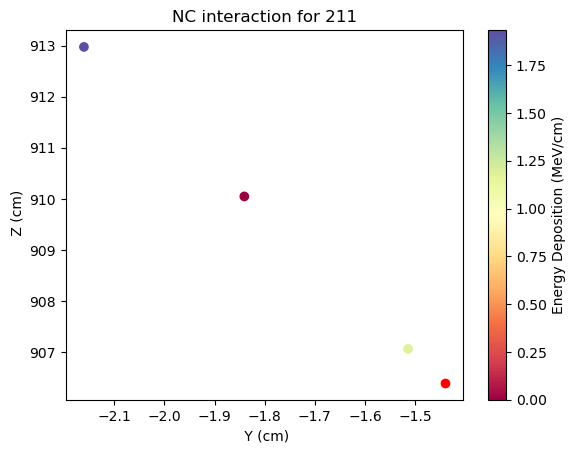

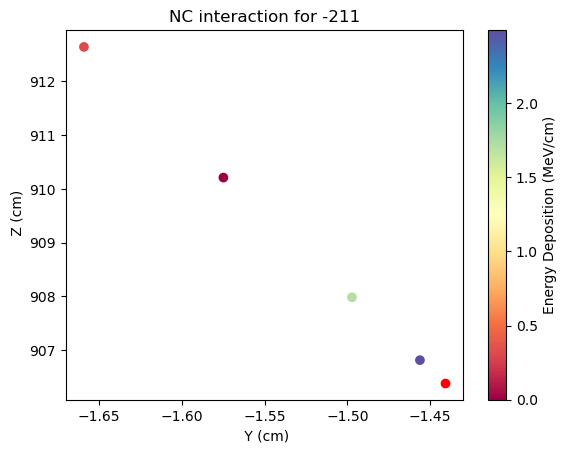

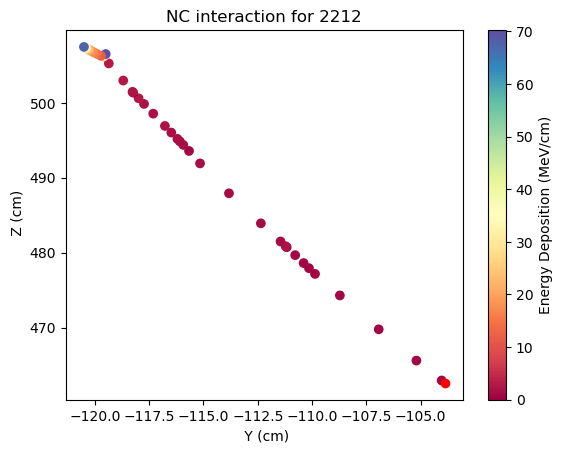

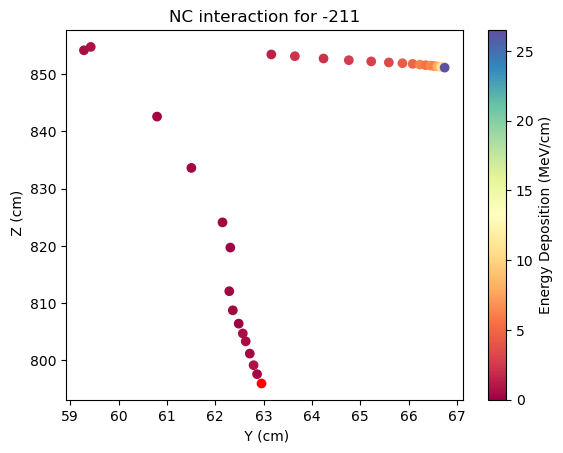

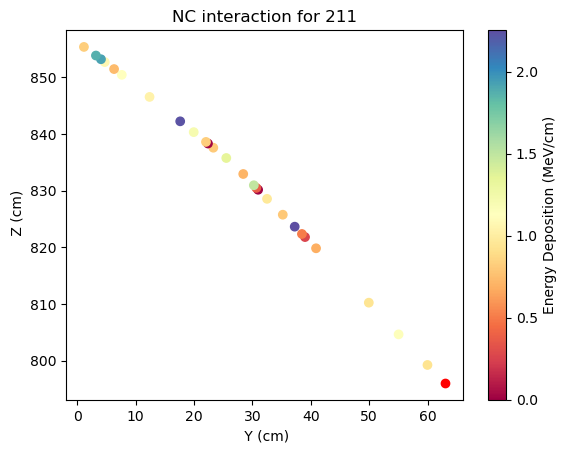

...

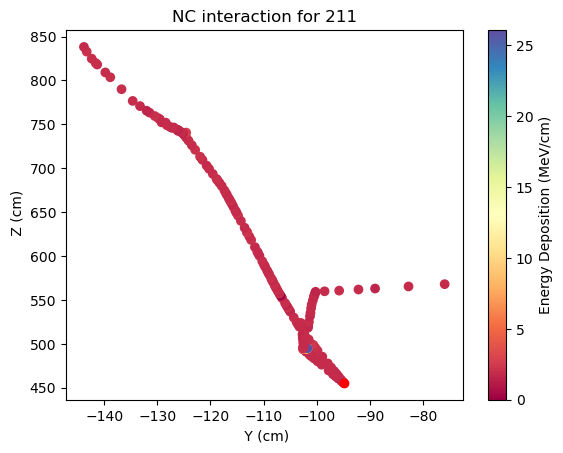

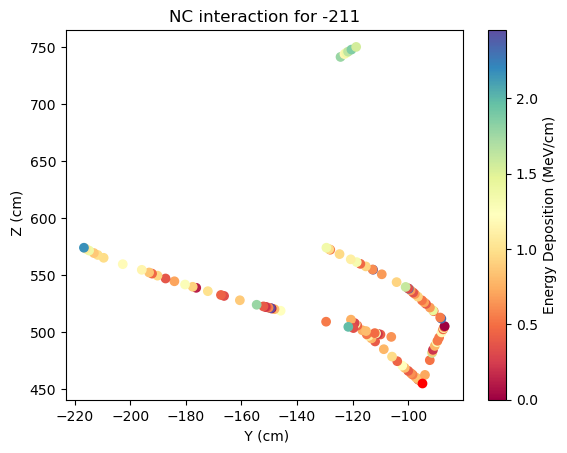

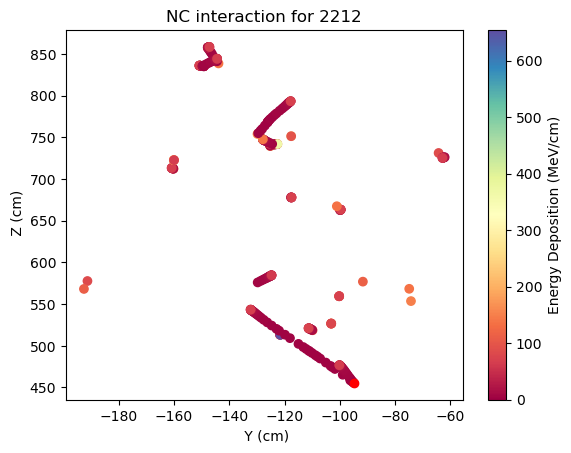

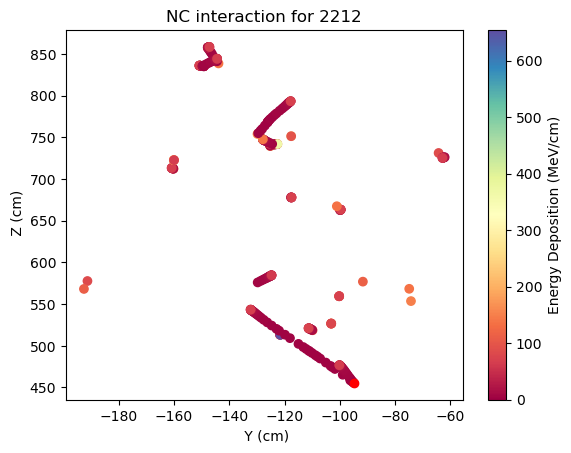

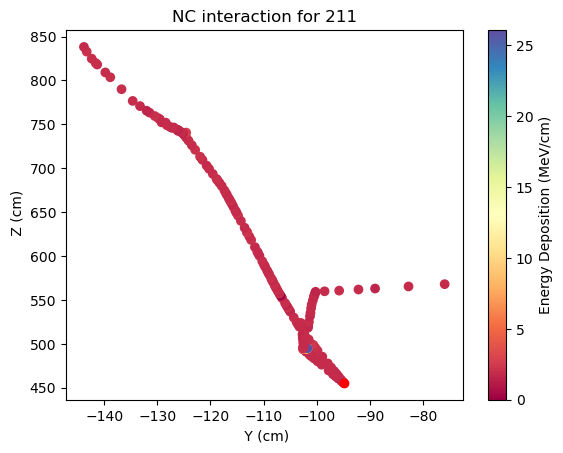

In [ ]:
file=PdfPages("Interaction Graphs.pdf ")
for id in events_ids:
    mc_event=mc_hdr[mc_hdr['event_id']==id]
    NC_EVENTS=mc_event[mc_event['isCC']==False]
    event_seg=segments[segments['event_id']==id]
    print(id)
    interact_part=[]
    interact_vert=[]
    for vcoord in NC_EVENTS:
        for points in event_seg:
            if ((points['x_start']==vcoord['x_vert']) and (points['y_start']==vcoord['y_vert']) and (points['z_start']==vcoord['z_vert'])):
            #This are the particles that interacted with the neutrinos
                #print(points['x_start'],vcoord['x_vert'])
                interact_part.append(points['pdg_id'])
                interact_vert.append(points['vertex_id'])
    #print(interact_part,interact_vert)
    N=len(interact_part)
    i=0
    while i<N:
        one_kind= event_seg[event_seg['pdg_id']==interact_part[i]]
        print(i,interact_part[i],interact_vert[i])
        one_part=one_kind[one_kind['vertex_id']==interact_vert[i]]
        #Figure config
        figure, bars= plt.subplots()
        norm=colors.Normalize(0,np.max(one_part['dEdx']))
        bars.set_title("NC interaction for "+str(interact_part[i]))
        bars.set_xlabel(" Y (cm)" )
        bars.set_ylabel(" Z (cm)")
        bars.scatter(one_part['y'],one_part['z'],c=one_part['dEdx'],cmap='Spectral')
        print(interact_vert,NC_EVENTS['vertex_id'])
        print(len(interact_vert),len(NC_EVENTS['vertex_id']))
        if interact_vert[i] in NC_EVENTS['vertex_id']:
            index=int(np.where(NC_EVENTS['vertex_id']==interact_vert[i])[0])
            print(index)
        bars.scatter(NC_EVENTS['y_vert'][index],NC_EVENTS['z_vert'][index],c='r')
        figure.colorbar(cm.ScalarMappable(norm=norm,cmap='Spectral'),ax=bars,label="Energy Deposition (MeV/cm)")
        file.savefig(figure)
        #plt.show()
        i+=1
    #del interact_part[:]
    #del interact_vert[:]
file.close()

In [3]:
#We grab the events that are Neutral Current ones (isCC returns false)
NC_EVENTS=mc_event[mc_event['isCC']==False]
#We print the amount of this kind of event.
print("The neutral current events are: " +str(len(NC_EVENTS)) )
print("")
print(NC_EVENTS.dtype)
print(NC_EVENTS)

The neutral current events are: 5

{'names': ['event_id', 'vertex_id', 'x_vert', 'y_vert', 'z_vert', 't_vert', 'target', 'reaction', 'isCC', 'isQES', 'isMEC', 'isRES', 'isDIS', 'isCOH', 'Enu', 'nu_4mom', 'nu_pdg', 'Elep', 'lep_mom', 'lep_ang', 'lep_pdg', 'q0', 'q3', 'Q2', 'x', 'y'], 'formats': ['<u4', '<u8', '<f4', '<f4', '<f4', '<f8', '<u4', '<i4', '?', '?', '?', '?', '?', '?', '<f4', ('<f4', (4,)), '<i4', '<f4', '<f4', '<f4', '<i4', '<f4', '<f4', '<f4', '<f4', '<f4'], 'offsets': [0, 8, 16, 20, 24, 32, 40, 44, 48, 49, 50, 51, 52, 53, 56, 60, 76, 80, 84, 88, 92, 96, 100, 104, 108, 112], 'itemsize': 120}
[(100134, 1009000150,  227.17836,   88.06324 , 615.68066, 1.60800000e+08,  0, 7, False, False, False, False, False, False,  1251.4462, [ 9.5473022e+00, -1.1873251e+02,  1.2457644e+03,  1.2514462e+03],  14, 1020.7192, 1020.7192,  1.7263508,  14,   230.72707,   231.23749, 2.3579688e+02, 5.4460391e-04, 0.18436831)
 (100134, 1009000151,  234.59677,  -69.66952 , 916.74164, 1.60800000e+08, 18

We have three neutral current events. To obtain more info regarding the event id and the vertex id, so we can know what particles are the ones interacting in this neutral current event.

In [4]:
#Now we work with the segments part. 
#We want to obtain the particles that match the vertex of interaction. 
event_seg=segments[segments['event_id']==100001]


interact_part=[]
interact_vert=[]
for vcoord in NC_EVENTS:
    for points in event_seg:
        if ((points['x_start']==vcoord['x_vert']) and (points['y_start']==vcoord['y_vert']) and (points['z_start']==vcoord['z_vert'])):
            #This are the particles that interacted with the neutrinos
            print(points['x_start'],vcoord['x_vert'])
            interact_part.append(points['pdg_id'])
            interact_vert.append(points['vertex_id'])

print(event_seg.dtype)
print("The particles that interact in a neutral current interaction are")
print(interact_part)
print("And their corresponding vertex")
print(interact_vert)

#Let's see if we can isolate the trajectory of one of those particles. 
one_kind= event_seg[event_seg['pdg_id']==interact_part[2]]
one_part=one_kind[one_kind['vertex_id']==interact_vert[2]]
print(one_part)
plt.scatter(one_part['y'],one_part['z'])
plt.scatter(NC_EVENTS['y_vert'][1],NC_EVENTS['z_vert'][1])
plt.show()
#for id in interact_part:
 #   interact_segm=event_seg[event_seg['pdg_id']==id]
  #  for vid in interact_vert:
   ##if np.abs(id)==211:
     #   one_interact=interact_segm[interact_segm['vertex_id']==1000000003]
      #  plt.scatter(one_interact['y'],one_interact['z'])
#    elif np.abs(id)==2212:
#        one_interact=interact_segm[interact_segm['vertex_id']==1000000004]
#        neutron=one_interact[one_interact['segment_id']==1723]
#        plt.scatter(neutron['y'],neutron['z'])
#plt.scatter(NC_EVENTS['y_vert'][0],NC_EVENTS['z_vert'][0])
#plt.show()

print()
#The results are telling us that we have interacting pions and a neutron interacting with the muon neutrino.
# We should reconstruct the trajectorie of that particle and observe if it's visible. 

stack_event=mc_stack[mc_stack['event_id']==100000]
stack_event[stack_event['vertex_id']==1000000003]
event_traj=trajectories[trajectories['event_id']==100000]
vertex_traj=event_traj[event_traj['vertex_id']==1000000003]
neutrino_traj=vertex_traj[vertex_traj['pdg_id']==14]
#neutrino_traj

{'names': ['event_id', 'vertex_id', 'segment_id', 'z_end', 'traj_id', 'file_traj_id', 'tran_diff', 'z_start', 'x_end', 'y_end', 'n_electrons', 'pdg_id', 'x_start', 'y_start', 't_start', 't0_start', 't0_end', 't0', 'dx', 'long_diff', 'pixel_plane', 't_end', 'dEdx', 'dE', 't', 'y', 'x', 'z', 'n_photons'], 'formats': ['<u4', '<u8', '<u4', '<f4', '<u4', '<u4', '<f4', '<f4', '<f4', '<f4', '<u4', '<i4', '<f4', '<f4', '<f8', '<f8', '<f8', '<f8', '<f4', '<f4', '<i4', '<f8', '<f4', '<f4', '<f8', '<f4', '<f4', '<f4', '<f4'], 'offsets': [0, 8, 16, 20, 24, 28, 32, 36, 40, 44, 48, 52, 56, 60, 64, 72, 80, 88, 96, 100, 104, 112, 120, 124, 128, 136, 140, 144, 148], 'itemsize': 152}
The particles that interact in a neutral current interaction are
[]
And their corresponding vertex
[]


IndexError: list index out of range